In [1]:
from radstats import environment
env = environment.event('events/october1989.txt')
env

,SEP 0.6 MeV,SEP 4.2 MeV,SEP 8.7 MeV,SEP 15.0 MeV,SEP 39.0 MeV,SEP 84.0 MeV,SEP 110.0 MeV,Rate (krad/s),dTID,TID,Time (s),Time (hrs),SegmentNum
time_tag,,,,,,,,,,,,,
1989-10-19 12:00:00,0.304689,0.050805,0.000000,0.005469,0.007667,0.001417,0.000654,1.402249e-09,8.413492e-08,8.413492e-08,0.0,0.000000,0
1989-10-19 12:01:00,0.285866,0.076208,0.057469,0.007278,0.003838,0.002066,0.000290,2.164644e-09,1.298786e-07,2.140136e-07,60.0,0.016667,0
1989-10-19 12:02:00,0.361156,0.000000,0.000000,0.005469,0.000000,0.001889,0.000327,9.946040e-10,5.967624e-08,2.736898e-07,120.0,0.033333,0
1989-10-19 12:03:00,0.456445,0.000000,0.115213,0.000000,0.002552,0.001653,0.000581,2.569077e-09,1.541446e-07,4.278344e-07,180.0,0.050000,0
1989-10-19 12:04:00,0.296454,0.000000,0.000000,0.000000,0.005743,0.001889,0.000399,8.994641e-10,5.396785e-08,4.818023e-07,240.0,0.066667,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1989-10-31 23:55:00,0.551733,0.203220,0.000000,0.049228,0.007667,0.001889,0.000435,3.782915e-09,2.269749e-07,3.734549e+00,1079700.0,299.916667,0
1989-10-31 23:56:00,0.532911,0.152415,0.229740,0.025511,0.010228,0.001417,0.000327,5.785683e-09,3.471410e-07,3.734549e+00,1079760.0,299.933333,0
1989-10-31 23:57:00,0.551733,0.152415,0.086410,0.043767,0.013419,0.001771,0.000509,4.531975e-09,2.719185e-07,3.734549e+00,1079820.0,299.950000,0


In [2]:
from radstats import plot
plot.dir = 'plots'
cols = []
for col in env.columns:
    if col.startswith('SEP'): cols.append(col)
import plotly.express as px
px.line(env[cols],log_y=True).update_layout(plot.layout,showlegend=True)

In [3]:
from radstats import models
parts = models.example
import pandas as pd
pd.DataFrame(parts)

,GCR,Protons,Dose
SRAM_SEFI,"{'Saturation': 1e-06, 'Threshold': 10}","{'Saturation': 1e-10, 'Threshold': 50}",NaN
SRAM_SEL,"{'Saturation': 1e-07, 'Threshold': 15}",NaN,NaN
MCU_SEFI,"{'Saturation': 2e-06, 'Threshold': 8}","{'Saturation': 2e-10, 'Threshold': 40}",NaN
MCU_SEL,"{'Saturation': 2e-07, 'Threshold': 12}",NaN,NaN
LREG_SEGR,"{'Saturation': 3e-07, 'Threshold': 20}",NaN,NaN
SRAM_TID,NaN,NaN,"{'Mean': 4, 'StDev': 0.1}"
MCU_TID,NaN,NaN,"{'Mean': 3.5, 'StDev': 0.1}"
LREG_TID,NaN,NaN,"{'Mean': 4.5, 'StDev': 0.1}"


In [4]:
events = models.events(env,parts,'diff')
events

,SRAM_SEFI,SRAM_SEL,MCU_SEFI,MCU_SEL,LREG_SEGR,SRAM_TID,MCU_TID,LREG_TID
Time (hrs),,,,,,,,
0.000000,3.528130e-10,0.0,7.056261e-10,0.0,0.0,0.0,0.0,0.0
0.016667,4.627245e-10,0.0,9.254489e-10,0.0,0.0,0.0,0.0,0.0
0.033333,4.278573e-10,0.0,8.557146e-10,0.0,0.0,0.0,0.0,0.0
0.050000,3.973984e-10,0.0,7.947970e-10,0.0,0.0,0.0,0.0,0.0
0.066667,4.334925e-10,0.0,8.669850e-10,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
299.916667,4.363487e-10,0.0,8.726975e-10,0.0,0.0,0.0,0.0,0.0
299.933333,3.272616e-10,0.0,6.545231e-10,0.0,0.0,0.0,0.0,0.0
299.950000,4.169122e-10,0.0,8.338245e-10,0.0,0.0,0.0,0.0,0.0


In [5]:
plot.probs(events)

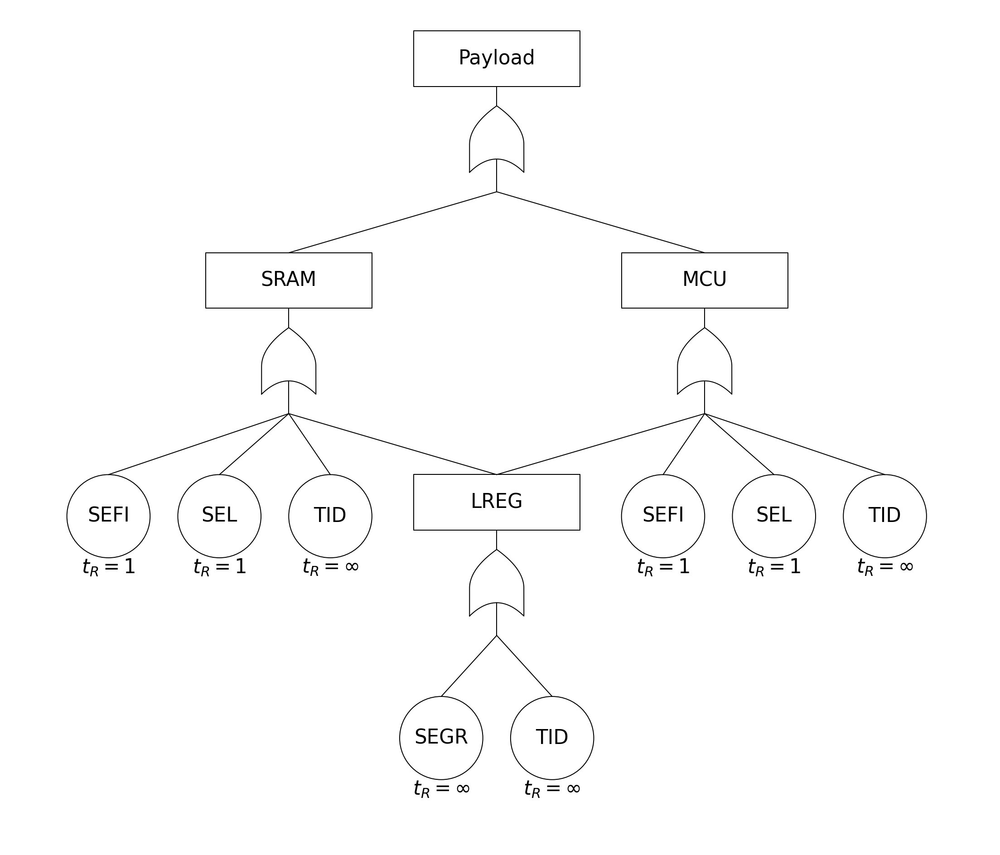

In [6]:
from lxml import etree
from radstats import diagram
system = etree.parse('sys/payload.xml')
subsystem = 'Payload'
diagram.FT(system,subsystem)

In [7]:
from radstats import bayes
faults = bayes.faults(system,events,subsystem)

In [8]:
plot.probs(faults)

In [9]:
plot.heatmap(faults,log=True)

In [10]:
impo = bayes.importance(system,faults,subsystem)
impo['diagnostic'].astype(float)

,SRAM_SEFI,SRAM_SEL,SRAM_TID,LREG_SEGR,LREG_TID,MCU_SEFI,MCU_SEL,MCU_TID,SRAM,LREG,MCU,Payload
Time (hrs),,,,,,,,,,,,
0.000000,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
0.016667,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
0.033333,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
0.050000,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
0.066667,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
299.916667,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
299.933333,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0
299.950000,0.333333,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.333333,0.0,0.666667,1.0


In [11]:
plot.probs(impo['diagnostic'],labels={'value':'Diagnostic Importance','variable':'Element'})

In [12]:
plot.bar(impo['diagnostic'].mean(),log=False,labels={'value':'Mean Diagnostic Importance','index':'Element'})